In [1]:
import geopandas as gpd
import pandas as pd
from shapely.geometry import Point
%matplotlib inline
import seaborn as sns; sns.set_theme(color_codes=True)
pd.set_option('display.max_columns', None)
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.colors
import warnings
warnings.filterwarnings('ignore')
from scipy import stats
import math

In [2]:
labels = gpd.read_file('data/processed-labels/seattle_labels_all/seattle_labels_all.shp')
curb = labels.loc[(labels['label_type']=='CurbRamp')]
#change coordinate system
curb = curb.to_crs("EPSG:2285")
no_curb = labels.loc[(labels['label_type']=='NoCurbRamp')]
no_curb = no_curb.to_crs("EPSG:2285")

In [19]:
#read in shapefile data/seattle-osm-roads.shp
roads = gpd.read_file('data/seattle-osm-roads/seattle-osm-roads.shp')

In [45]:
#roads.explore( column='highway', tiles='cartodbpositron', cmap='Set2')

In [4]:
#change highway column name to way_type
roads.rename(columns={'highway':'way_type'}, inplace=True)

In [5]:
#drop way_type = motorway and motorway_link
roads = roads[roads.way_type != 'motorway']
roads = roads[roads.way_type != 'motorway_link']

In [6]:
roads

,way_type,osmid,geometry
21,secondary,426250827,"LINESTRING (-122.30363 47.64413, -122.30389 47..."
22,primary,4636259,"LINESTRING (-122.30363 47.64413, -122.30369 47..."
23,primary,361443212,"LINESTRING (-122.30363 47.64413, -122.30369 47..."
24,primary,431103955,"LINESTRING (-122.30363 47.64413, -122.30369 47..."
25,secondary,332060260,"LINESTRING (-122.30389 47.64403, -122.30395 47..."
...,...,...,...
62595,residential,340365566,"LINESTRING (-122.34106 47.63658, -122.34134 47..."
62596,residential,1138304083,"LINESTRING (-122.30830 47.49990, -122.30830 47..."
62597,residential,6399535,"LINESTRING (-122.30830 47.49933, -122.30741 47..."
62598,residential,1138304083,"LINESTRING (-122.30830 47.49933, -122.30830 47..."


In [7]:
# Extract start and end coordinates of each linestring
first_coord = roads["geometry"].apply(lambda g: g.coords[0])
last_coord = roads["geometry"].apply(lambda g: g.coords[-1])

# Add start and end as columns to the s
roads["start_coord"] = first_coord
roads["end_coord"] = last_coord

In [8]:
p0 = roads[['start_coord', 'way_type']]
p1 = roads[['end_coord','way_type']]
p0 = p0.rename(columns={'start_coord':'coord'})
p1 = p1.rename(columns={'end_coord':'coord'})
result = pd.concat([p0,p1])
result = result.drop_duplicates(subset=['coord','way_type'], keep='first')
result

,coord,way_type
21,"(-122.3036315, 47.6441329)",secondary
22,"(-122.3036315, 47.6441329)",primary
25,"(-122.303892, 47.6440305)",secondary
34,"(-122.3014251, 47.6583247)",primary
38,"(-122.3021215, 47.6560111)",primary
...,...,...
62365,"(-122.3182273, 47.6017022)",secondary_link
62486,"(-122.31338, 47.5638073)",tertiary
62487,"(-122.3132123, 47.563601)",secondary_link
62493,"(-122.3200798, 47.5473539)",residential


In [9]:
#convert points into gpd
points = result.apply(lambda row: Point(row), axis=1)
#fix coordinate system
p_geo = gpd.GeoDataFrame(result, geometry=points)
p_geo.crs = {'init': 'epsg:4326'}
p_geo = p_geo.to_crs("EPSG:2285")
p_geo

,coord,way_type,geometry
21,"(-122.3036315, 47.6441329)",secondary,POINT (1278000.237 238421.440)
22,"(-122.3036315, 47.6441329)",primary,POINT (1278000.237 238421.440)
25,"(-122.303892, 47.6440305)",secondary,POINT (1277935.320 238385.322)
34,"(-122.3014251, 47.6583247)",primary,POINT (1278642.794 243586.795)
38,"(-122.3021215, 47.6560111)",primary,POINT (1278455.097 242746.302)
...,...,...,...
62365,"(-122.3182273, 47.6017022)",secondary_link,POINT (1274104.275 223016.157)
62486,"(-122.31338, 47.5638073)",tertiary,POINT (1275034.052 209172.938)
62487,"(-122.3132123, 47.563601)",secondary_link,POINT (1275074.000 209096.904)
62493,"(-122.3200798, 47.5473539)",residential,POINT (1273264.306 203204.319)


In [22]:
#Spatial join project sidewalk labels to sidewalk geometry
curb_to_intersection = curb.sjoin_nearest(p_geo, distance_col='distance')
curb_to_intersection

,label_id,label_type,severity,gsv_panora,zoom,heading,pitch,photograph,photogra_1,user_id,lat,lng,geometry,index_right,coord,way_type,distance
0,85055,CurbRamp,1.0,NjPAkwTxWsayAq3kCugvdA,1,107.750000,-15.625000,270.556610,0.907036,4f2a3a9a-a5d5-4d57-b2d1-6be61a6c2184,47.618599,-122.332787,POINT (1270633.170 229247.981),22400,"(-122.3330009, 47.6185263)",residential,59.130699
16012,101038,CurbRamp,1.0,lq6_t34fb1KNDKlkTuiHnQ,2,24.008928,-12.232142,90.617798,1.109062,0e1ae564-6d72-4670-98e4-71369cc5ab26,47.618610,-122.332863,POINT (1270614.439 229252.521),22400,"(-122.3330009, 47.6185263)",residential,45.823490
16013,101041,CurbRamp,1.0,lq6_t34fb1KNDKlkTuiHnQ,1,127.678574,-35.000000,90.617798,1.109062,0e1ae564-6d72-4670-98e4-71369cc5ab26,47.618462,-122.332970,POINT (1270587.043 229198.777),22400,"(-122.3330009, 47.6185263)",residential,24.822625
16027,101039,CurbRamp,1.0,lq6_t34fb1KNDKlkTuiHnQ,2,24.008928,-12.232142,90.617798,1.109062,0e1ae564-6d72-4670-98e4-71369cc5ab26,47.618633,-122.332932,POINT (1270597.670 229261.198),22400,"(-122.3330009, 47.6185263)",residential,42.606179
34329,90505,CurbRamp,1.0,Z_eTIaeGBVmlni66TM0GHQ,1,130.125000,0.000000,270.473511,0.796036,4f2a3a9a-a5d5-4d57-b2d1-6be61a6c2184,47.618481,-122.332962,POINT (1270589.060 229205.697),22400,"(-122.3330009, 47.6185263)",residential,19.202894
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
195006,66623,CurbRamp,2.0,fb1X-sizqcJWy2XacnpTDQ,1,298.437500,0.000000,343.513855,0.705017,86d26e9d-010f-4802-88ba-680ae0a8e20d,47.540035,-122.341385,POINT (1267951.368 200637.626),5747,"(-122.3414925, 47.5398923)",secondary,58.526402
195247,82161,CurbRamp,2.0,IGAeXyDN27V8zXhemMZ-Pw,1,65.812500,-10.750000,178.692993,1.671494,aba0d1a6-28a1-4591-a585-58afa22a134e,47.559467,-122.315971,POINT (1274363.891 207602.473),28637,"(-122.3160956, 47.5594333)",residential,33.086851
195276,82646,CurbRamp,3.0,t2B5o_zy7IS_0iaoLReK8g,1,162.562500,-28.687500,357.304321,1.398743,4f2a3a9a-a5d5-4d57-b2d1-6be61a6c2184,47.639652,-122.284790,POINT (1282613.114 236699.170),47920,"(-122.2848613, 47.6395533)",residential,40.142631
195343,83853,CurbRamp,1.0,93jou2QvBb6tLgB316F90Q,2,32.223213,-14.589286,12.216482,-0.631035,4f2a3a9a-a5d5-4d57-b2d1-6be61a6c2184,47.688496,-122.352486,POINT (1266279.108 254834.228),53468,"(-122.3526161, 47.6884352)",residential,38.963728


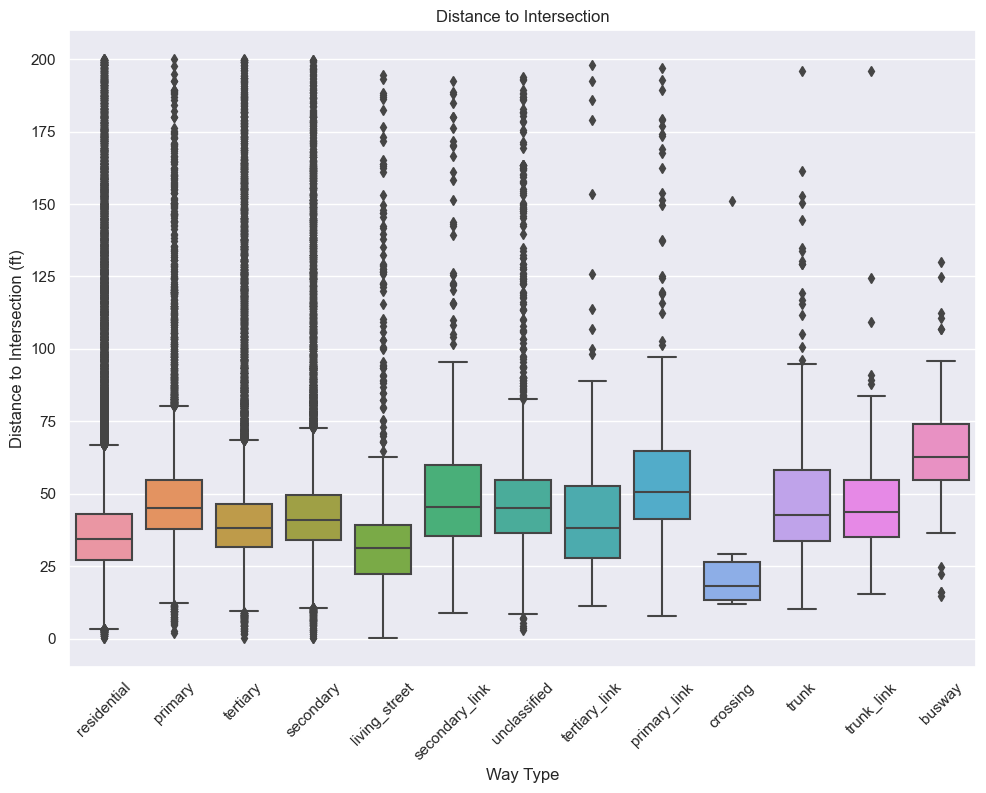

In [25]:
#select distance < 200 ft and do the same plot
distance_to_intersection = curb_to_intersection.loc[(curb_to_intersection['distance']<200)]
sns.set(rc={'figure.figsize':(11.7,8.27)})
ax = sns.boxplot(x="way_type", y="distance", data=distance_to_intersection)
ax.set_title('Distance to Intersection')
ax.set_xlabel('Way Type')
ax.set_ylabel('Distance to Intersection (ft)')
#rotate x-axis labels
plt.setp(ax.get_xticklabels(), rotation=45)
plt.show()

In [26]:
#select only label_id, way_type, distance
curb_to_intersection = curb_to_intersection[['label_id','way_type','distance']]

In [27]:
curb_to_intersection

,label_id,way_type,distance
0,85055,residential,59.130699
16012,101038,residential,45.823490
16013,101041,residential,24.822625
16027,101039,residential,42.606179
34329,90505,residential,19.202894
...,...,...,...
195006,66623,secondary,58.526402
195247,82161,residential,33.086851
195276,82646,residential,40.142631
195343,83853,residential,38.963728


In [28]:
#Spatial join project sidewalk labels to sidewalk geometry
no_curb_to_intersection = no_curb.sjoin_nearest(p_geo, distance_col='distance')
no_curb_to_intersection

,label_id,label_type,severity,gsv_panora,zoom,heading,pitch,photograph,photogra_1,user_id,lat,lng,geometry,index_right,coord,way_type,distance
27,85351,NoCurbRamp,5.0,7_z0vGJLYsML5I6VILmmNw,1,276.500000,-15.625000,180.397873,2.977348,4f2a3a9a-a5d5-4d57-b2d1-6be61a6c2184,47.656750,-122.351227,POINT (1266360.677 243250.531),19911,"(-122.3511036, 47.6566739)",residential,41.072593
11277,123544,NoCurbRamp,5.0,6XmtrZMZl9-mbt9kbk1Xkg,1,250.258926,-30.578125,180.615295,2.877937,7d65ec0f-4ba8-4895-abfb-eb75fab3104e,47.656620,-122.351196,POINT (1266367.263 243203.082),19911,"(-122.3511036, 47.6566739)",residential,30.132768
65645,85352,NoCurbRamp,5.0,7_z0vGJLYsML5I6VILmmNw,1,276.500000,-15.625000,180.397873,2.977348,4f2a3a9a-a5d5-4d57-b2d1-6be61a6c2184,47.656635,-122.351219,POINT (1266361.733 243208.758),19911,"(-122.3511036, 47.6566739)",residential,31.776185
81272,116346,NoCurbRamp,5.0,6XmtrZMZl9-mbt9kbk1Xkg,1,331.312500,0.000000,180.598831,2.986008,46f4d22f-addf-410a-89cf-f1ed05583206,47.656769,-122.351242,POINT (1266357.054 243257.562),19911,"(-122.3511036, 47.6566739)",residential,48.607911
107476,123543,NoCurbRamp,4.0,6XmtrZMZl9-mbt9kbk1Xkg,1,269.571442,-23.640625,180.615295,2.877937,7d65ec0f-4ba8-4895-abfb-eb75fab3104e,47.656639,-122.351273,POINT (1266348.601 243210.409),19911,"(-122.3511036, 47.6566739)",residential,43.537114
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
195065,67412,NoCurbRamp,3.0,HQCV5vbwM1tPE3N34EzYCg,3,110.578125,-10.484375,179.047775,-1.493439,ce993fd7-3a84-4155-acb6-f4fa5d5c8d2b,47.703213,-122.323021,POINT (1273638.698 260059.646),9627,"(-122.323161, 47.7031447)",secondary,42.489246
195075,67410,NoCurbRamp,3.0,HQCV5vbwM1tPE3N34EzYCg,2,231.667404,-23.392857,179.047775,-1.493439,ce993fd7-3a84-4155-acb6-f4fa5d5c8d2b,47.703255,-122.323296,POINT (1273571.379 260076.259),9627,"(-122.323161, 47.7031447)",secondary,52.040759
195115,67582,NoCurbRamp,4.0,M0PEN1VRto-EHY5WSIAL3Q,2,290.676331,-13.392858,249.167999,-0.134483,c7190807-b56e-40c5-b96e-49dc8368328c,47.661125,-122.298599,POINT (1279358.522 244594.857),1031,"(-122.2987058, 47.6612577)",secondary_link,55.009330
195234,81807,NoCurbRamp,3.0,4Jbq1GCz3rxilzjCv6f-JA,1,97.687500,0.000000,179.066284,0.442390,be87fc98-b84d-4793-860f-3b65a87dfc5f,47.706696,-122.328506,POINT (1272312.953 261356.019),47527,"(-122.3286011, 47.7068338)",secondary,55.548862


In [30]:
#select only label_id, way_type, distance
no_curb_to_intersection = no_curb_to_intersection[['label_id','way_type','distance']]

In [31]:
#concatenate curb and no curb
intersection_d = pd.concat([curb_to_intersection, no_curb_to_intersection])

In [32]:
intersection_d

,label_id,way_type,distance
0,85055,residential,59.130699
16012,101038,residential,45.823490
16013,101041,residential,24.822625
16027,101039,residential,42.606179
34329,90505,residential,19.202894
...,...,...,...
195065,67412,secondary,42.489246
195075,67410,secondary,52.040759
195115,67582,secondary_link,55.009330
195234,81807,secondary,55.548862


In [37]:
df = labels[['label_id']]

In [38]:
df

,label_id
0,85055
1,85057
2,85059
3,85060
4,85062
...,...
195538,231270
195539,231285
195540,231338
195541,231339


In [39]:
#merge labels and intersection_d
df = df.merge(intersection_d, on='label_id', how='left')

In [43]:
#group by label_id choose first way_type and distance
df = df.groupby('label_id').first().reset_index()
df

,label_id,way_type,distance
0,9,tertiary,40.679454
1,10,tertiary,36.863199
2,11,None,NaN
3,12,None,NaN
4,13,None,NaN
...,...,...,...
195538,233233,None,NaN
195539,233234,None,NaN
195540,233235,None,NaN
195541,233236,tertiary,53.975477


In [44]:
df.to_csv('data/features/intersection_distance.csv', index=False)